<a href="https://colab.research.google.com/github/howard-haowen/Chinese-NLP/blob/main/NLPdemo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from traitlets.config.manager import BaseJSONConfigManager
from pathlib import Path

In [ ]:
path = Path.home() / ".jupyter" / "nbconfig"
cm = BaseJSONConfigManager(config_dir=str(path))
cm.update(
    "rise",
    {
        "autolaunch": True,
        "enable_chalkboard": True,
        "scroll": True,
        "slideNumber": True,
        "controls": True,
        "progress": True,
        "history": True,
        "center": True,
        "width": "90%",
        "height": "90%",
        "theme": "beige",
        "transition": "concave",
        "start_slideshow_at": "selected"
     }
)

機器學習基本流程

![](https://2s7gjr373w3x22jf92z99mgm5w-wpengine.netdna-ssl.com/wp-content/uploads/2018/09/WD_3.png)

# 下載資料 

In [ ]:
import pandas as pd

In [ ]:
data_path = "online_shopping_5_cats_tra.csv"
df = pd.read_csv(data_path)
df.sample(5, random_state=100)

,cat,label,review
4253,平板,1,支援國產，效能不錯，孩子玩的，大小合適，螢幕靚麗。值得購買。
30076,衣服,1,衣服穿著還可以，就是快遞有點慢。
48047,酒店,0,非常差 沒有窗戶 一點也不乾淨
1666,平板,1,東西不錯，這個價格很酷，喜歡，會推薦購買
30740,衣服,1,不錯褲子質量好，到貨也快只是我評價晚了些


In [ ]:
df['cat'].value_counts()

洗髮水    10000
平板     10000
水果     10000
衣服     10000
酒店     10000
Name: cat, dtype: int64

In [ ]:
df['label'].value_counts()

1    25000
0    25000
Name: label, dtype: int64

In [ ]:
%load_ext google.colab.data_table
from google.colab import data_table
data_table.DataTable(df, include_index=True, num_rows_per_page=10)

,cat,label,review
0,平板,1,﻿很不錯。。。。。。很好的平板
1,平板,1,幫同學買的，同學說感覺挺好，質量也不錯
2,平板,1,東西不錯，一看就是正品包裝，還沒有開機，相信京東，都是老顧客，還是京東值得信賴，給五星好評
3,平板,1,總體而言，產品還是不錯的。
4,平板,1,好，不錯，真的很好不錯
...,...,...,...
49995,酒店,0,我們去鹽城的時候那裡的最低氣溫只有4度，晚上冷得要死，居然還不開空調，投訴到酒店客房部，得到...
49996,酒店,0,房間很小，整體設施老化，和四星的差距很大。毛巾太破舊了。早餐很簡陋。房間隔音很差，隔兩間房間...
49997,酒店,0,我感覺不行。。。價效比很差。不知道是銀川都這樣還是怎麼的！
49998,酒店,0,房間時間長，進去有點異味！服務員是不是不夠用啊！我在一樓找了半個小時以上才找到自己房間，想找...


# 基本語言分析

## 斷詞

In [ ]:
!pip install -q -U pip setuptools wheel 
!pip install -q -U spacy
!python -m spacy download zh_core_web_md

     |████████████████████████████████| 1.7 MB 5.2 MB/s 
     |████████████████████████████████| 946 kB 49.5 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires notebook~=5.3.0; python_version >= "3.0", but you have notebook 6.4.5 which is incompatible.
google-colab 1.0.0 requires tornado~=5.1.0; python_version >= "3.0", but you have tornado 6.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
     |████████████████████████████████| 5.9 MB 5.0 MB/s            
     |████████████████████████████████| 451 kB 46.2 MB/s            
     |████████████████████████████████| 628 kB 65.0 MB/s            
     |████████████████████████████████| 42 kB 1.4 MB/s             
     |████████████████████████████████| 10.1 MB 56.1 MB/s            
     |██████████████████████████████

In [ ]:
import spacy

nlp = spacy.load("zh_core_web_md")
nlp.pipe_names

['tok2vec', 'tagger', 'parser', 'attribute_ruler', 'ner']

In [ ]:
text = df.at[10528, 'review']
text

'送人的，不知道好不好。聽說紅心火龍果還是比較甜的。'

In [ ]:
text = df.at[10528, 'review']
doc = nlp(text)
tokens = [tok.text for tok in doc]
" | ".join(tokens)

In [ ]:
# Clone the entire repo.
!git clone -l -s https://github.com/L706077/jieba-zh_TW.git jieba_tw
%cd jieba_tw
!ls

Cloning into 'jieba_tw'...
remote: Enumerating objects: 2320, done.
remote: Total 2320 (delta 0), reused 0 (delta 0), pack-reused 2320
Receiving objects: 100% (2320/2320), 36.07 MiB | 21.46 MiB/s, done.
Resolving deltas: 100% (1498/1498), done.
/content/jieba_tw
Changelog  jieba  LICENSE  MANIFEST.in	README.md


In [ ]:
import jieba

In [ ]:
text = df.at[10528, 'review']
tokens = jieba.cut(text) 
" | ".join(tokens)

Building prefix dict from the default dictionary ...
Dumping model to file cache /tmp/jieba.cache
Loading model cost 0.877 seconds.
Prefix dict has been built succesfully.


'送人 | 的 | ， | 不 | 知道 | 好不好 | 。 | 聽說 | 紅心 | 火龍果 | 還是 | 比較 | 甜 | 的 | 。'

## 依存句法

In [ ]:
from spacy import displacy

In [ ]:
text = """國立金門大學第1屆樂齡大學今天開學，30名長者展開36週的學習。"""
doc = nlp(text)
displacy.render(doc, style='dep',jupyter=True, options={'distance':130})

## 命名實體

In [ ]:
text = """
顏達仁曾是金門第1任副縣長，
今年進入金大進修部企管系1年級就讀，
不僅是本屆最高齡，
也是金大創校以來，
年紀最長的大學生。
"""
doc = nlp(text)
displacy.render(doc, style='ent',jupyter=True)

In [ ]:
!pip install -q dframcy

In [ ]:
from dframcy import DframCy

dframcy = DframCy(nlp)

In [ ]:
sample = df.at[9999, 'review']
doc = dframcy.nlp(sample)
annotation_dataframe = dframcy.to_dataframe(doc)
annotation_dataframe

,token_text,token_start,token_end,token_pos_,token_tag_,token_dep_,token_head
0,反正,0,2,ADV,AD,advmod,買
1,買,2,3,VERB,VV,dep,拿
2,回來,3,5,VERB,VV,dobj,買
3,一,5,6,NUM,CD,dep,買
4,個,6,7,NUM,M,mark:clf,一
5,禮拜,7,9,ADV,AD,advmod,拿
6,就要,9,11,VERB,VV,xcomp,拿
7,拿,11,12,VERB,VV,ROOT,拿
8,回去,12,14,VERB,VV,advmod:rcomp,拿
9,維修,14,16,VERB,VV,conj,拿


## 詞頻統計

In [ ]:
!pip install -q scattertext

     |████████████████████████████████| 7.3 MB 24.4 MB/s            
     |████████████████████████████████| 24.1 MB 62.2 MB/s            
  Preparing metadata (setup.py) ... done


In [ ]:
import scattertext as st

In [ ]:
df['cat'].unique()

array(['平板', '水果', '洗髮水', '衣服', '酒店'], dtype=object)

In [ ]:
filt = (df['cat'] == '水果') | (df['cat'] == '洗髮水')
sample_data = df[filt].sample(500, random_state=100)
sample_data

,cat,label,review
12917,水果,1,非常好，酸甜適宜，蘋果芯可以看出很新鮮！會繼續回購。
12234,水果,1,京東的發貨速度那是沒話說，蘋果有一個果不新鮮，其它都挺好，希望品質再好一點…
24396,洗髮水,1,已收到貨，完整無缺，已用上，不錯，快遞很好，
11781,水果,1,蘋果很漂亮，送禮蠻顯檔次。但是說實在的，不算好吃
21102,洗髮水,1,京東的快遞就是快，而且這個套盒也很優惠，之前用過沙宣的很好用
...,...,...,...
26460,洗髮水,0,不是說有吹風機送麼？？？買了兩套連個毛也沒送
12131,水果,1,包裝完好，配送快，甜脆可口。非常好。
20518,洗髮水,1,快遞員送貨上門，下著雨辛苦了，東西還沒用，包裝完好，價格實惠。第一次用這個牌子，期待效果。
17142,水果,0,我買的也都是爛的，差評！不要買!


In [ ]:
corpus = st.CorpusFromPandas(sample_data,
                             category_col='cat',
                             text_col='review',
                             nlp=nlp).build()

In [ ]:
term_freq_df = corpus.get_term_freq_df()
term_freq_df

,水果 freq,洗髮水 freq
term,,
非常,39,10
好,90,68
酸甜適宜,1,0
蘋果,131,0
芯,1,0
...,...,...
並 不是,0,1
很 濃,0,1
濃 限用,0,1


In [ ]:
html = st.produce_scattertext_explorer(corpus, 
                                       category='水果', 
                                       category_name='水果', 
                                       not_category_name='洗髮水',
                                       width_in_pixels=1000, 
                                       metadata=sample_data['label'])

#open("scattertext_01.html",'wb').write(html.encode('utf-8'))

In [ ]:
from IPython.display import display, HTML

display(HTML(html))

In [ ]:
filt = (df['cat'] == '水果') | (df['cat'] == '平板')
sample_data = df[filt].sample(500, random_state=100)
sample_data

,cat,label,review
2917,平板,1,用了幾天才來評價的，不錯，很清晰，就是通話得耳機
2234,平板,1,手機很好，客服不錯，快遞也很給力
14396,水果,1,好蘋果，清脆可口，水分很足，非常好吃，下次還要再買。
1781,平板,1,寶貝收到了。大小合適非常滿意。京東的東西值得信賴
11102,水果,1,蘋果酸酸甜甜脆的味道不錯，肉質比較實應該是現摘的還未長夠日子的晚些時候再買果肉鬆化了可能更好...
...,...,...,...
16460,水果,0,三個，切了一個吃了，有點壞了，不過忘了沒拍照，同時買的藍梅，兩盒也有一盒壞了，
2131,平板,1,螢幕亮度不夠亮，其他還好啊
10518,水果,1,看著降價一下買了三箱，已經多次購買此蘋果了，蘋果品質很好，味道不錯，非常喜歡，物流速度快，快...
7142,平板,0,電池太渣，給一星都多了


In [ ]:
corpus = st.CorpusFromPandas(sample_data,
                             category_col='cat',
                             text_col='review',
                             nlp=nlp).build()
html = st.produce_scattertext_explorer(corpus, 
                                       category='水果', 
                                       category_name='水果', 
                                       not_category_name='平板',
                                       width_in_pixels=1000, 
                                       metadata=sample_data['label'])
display(HTML(html))

# 文本預處理

In [ ]:
text = """
顏達仁曾是金門第1任副縣長，
今年進入金大進修部企管系1年級就讀，
不僅是本屆最高齡，
也是金大創校以來，
年紀最長的大學生。
"""
text

'\n顏達仁曾是金門第1任副縣長，\n今年進入金大進修部企管系1年級就讀，\n不僅是本屆最高齡，\n也是金大創校以來，\n年紀最長的大學生。\n'

In [ ]:
text = df.at[31902, 'review']
text

'褲子質量挺不錯的，料子很舒服，穿起來棒棒噠！顯得腿型特別好，也不褪色，不錯哦(-ω-`)建議大家購買'

In [ ]:
from spacy.tokens import Doc

class WhitespaceTokenizer:
    def __init__(self, vocab):
        self.vocab = vocab

    def __call__(self, text):
        words = text.strip().split()
        return Doc(self.vocab, words=words)

nlp = spacy.load("zh_core_web_md", disable=["tagger", "parser", "ner"])
nlp.tokenizer = WhitespaceTokenizer(nlp.vocab)

In [ ]:
def whitespace_cut(raw_text: str) -> str:
    tokens = jieba.cut(raw_text)
    results = " ".join(tokens)
    return results

In [ ]:
def preprocess_text(raw_text: str) -> str:
    raw_text_with_space = whitespace_cut(raw_text)
    doc = nlp.make_doc(raw_text_with_space)
    res = [tok for tok in doc if not tok.is_punct]
    res = [tok for tok in res if not tok.is_stop]
    res = [tok for tok in res if not tok.like_email]
    res = [tok for tok in res if not tok.like_url]
    res = [tok for tok in res if not tok.like_num]
    res = [tok for tok in res if not tok.is_ascii]
    res = [tok.text for tok in res if not tok.is_space]
    res = " ".join(res)
    return res

In [ ]:
tokenized_df = df.sample(1000, random_state=100)
tokenized_df['tokenized_text'] = tokenized_df['review'].apply(preprocess_text)
tokenized_df

,cat,label,review,tokenized_text
4253,平板,1,支援國產，效能不錯，孩子玩的，大小合適，螢幕靚麗。值得購買。,支援 國產 效能 不錯 孩子 玩 大小 合適 螢幕 靚麗 值得 購買
30076,衣服,1,衣服穿著還可以，就是快遞有點慢。,衣服 穿著 還可以 快遞 有點 慢
48047,酒店,0,非常差 沒有窗戶 一點也不乾淨,差 沒有 窗戶 一點 乾淨
1666,平板,1,東西不錯，這個價格很酷，喜歡，會推薦購買,東西 不錯 這 個 價格 很酷 喜歡 會 推薦 購買
30740,衣服,1,不錯褲子質量好，到貨也快只是我評價晚了些,不錯 褲子 質量 到貨 評價 晚了
...,...,...,...,...
1107,平板,1,很好的產品，流暢，清晰，音質好,產品 流暢 清晰 音質
31534,衣服,1,寶貝質量不錯，做工精細，完全符合我的要求,寶貝 質量 不錯 做工 精細 符合
35996,衣服,0,不合適袖口太大設計不好看,合適 袖口 太 設計 好看
37394,衣服,0,不值啊，穿一天就皺的一塌糊塗？30差不多,不值 穿 天 皺 一塌糊塗


# 文本表徵

電腦的世界只有數字

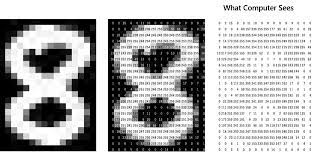

## TF-IDF

![](https://miro.medium.com/max/1000/1*vWWmJlDykVRkjg9c38VbxQ.png)

In [ ]:
!pip install -q -U texthero

     |████████████████████████████████| 10.4 MB 41.5 MB/s            
     |████████████████████████████████| 24.2 MB 1.6 MB/s             
     |████████████████████████████████| 1.5 MB 54.4 MB/s            
     |████████████████████████████████| 235 kB 76.1 MB/s            
     |████████████████████████████████| 748 kB 75.6 MB/s            
     |████████████████████████████████| 184 kB 53.3 MB/s            
     |████████████████████████████████| 1.0 MB 76.7 MB/s            
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
zh-core-web-md 3.1.0 requires spacy<3.2.0,>=3.1.0, but you have spacy 2.3.7 which is incompatible.
spacy-pkuseg 0.0.28 requires srsly<3.0.0,>=2.3.0, but you have srsly 1.0.5 which is incompatible.
scattertext 0.1.4 requires gensim>=4.0.0, but you have gensim 3.8.3 which is incompatible.
dframcy 0.1.6 requires spacy>=3.0.0, but you have sp

In [ ]:
import texthero as hero

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
/usr/local/lib/python3.7/dist-packages/spacy/util.py:766: UserWarning:

[W094] Model 'en_core_web_sm' (2.2.5) specifies an under-constrained spaCy version requirement: >=2.2.2. This can lead to compatibility problems with older versions, or as new spaCy versions are released, because the model may say it's compatible when it's not. Consider changing the "spacy_version" in your meta.json to a version range, with a lower and upper pin. For example: >=3.1.3,<3.2.0



✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [ ]:
tokenized_df['tfidf_text'] = hero.tfidf(tokenized_df['tokenized_text'])
tokenized_df[['cat', 'tokenized_text', 'tfidf_text']]

,cat,tokenized_text,tfidf_text
4253,平板,支援 國產 效能 不錯 孩子 玩 大小 合適 螢幕 靚麗 值得 購買,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
30076,衣服,衣服 穿著 還可以 快遞 有點 慢,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
48047,酒店,差 沒有 窗戶 一點 乾淨,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1666,平板,東西 不錯 這 個 價格 很酷 喜歡 會 推薦 購買,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
30740,衣服,不錯 褲子 質量 到貨 評價 晚了,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...
1107,平板,產品 流暢 清晰 音質,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
31534,衣服,寶貝 質量 不錯 做工 精細 符合,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
35996,衣服,合適 袖口 太 設計 好看,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
37394,衣服,不值 穿 天 皺 一塌糊塗,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [ ]:
len(tokenized_df.at[40316, 'tfidf_text'])

4566

## PCA

![](https://3.bp.blogspot.com/-aGt6JrHLt_E/WjXd4Ge7B-I/AAAAAAAAAgY/-gF8sXb4qqAwObOmP9hTiJa0ot5wR82ZACLcBGAs/s1600/Principal-Component-Analysis-And-Dimensionality-Reduction.jpg)

In [ ]:
tokenized_df['pca_tfidf_text'] = hero.pca(tokenized_df['tfidf_text'])
tokenized_df[['cat', 'tokenized_text', 'pca_tfidf_text']]

,cat,tokenized_text,pca_tfidf_text
4253,平板,支援 國產 效能 不錯 孩子 玩 大小 合適 螢幕 靚麗 值得 購買,"[0.17604510574450996, -0.012356678358579015]"
30076,衣服,衣服 穿著 還可以 快遞 有點 慢,"[0.09682279979482708, 0.050184877042200884]"
48047,酒店,差 沒有 窗戶 一點 乾淨,"[-0.11175954461159103, 0.15368502124272235]"
1666,平板,東西 不錯 這 個 價格 很酷 喜歡 會 推薦 購買,"[0.17935907765234657, -0.07561705459600851]"
30740,衣服,不錯 褲子 質量 到貨 評價 晚了,"[0.3061324928799049, 0.0014940917584579652]"
...,...,...,...
1107,平板,產品 流暢 清晰 音質,"[0.005448807754994039, 0.021713531667815613]"
31534,衣服,寶貝 質量 不錯 做工 精細 符合,"[0.2866309282222807, 0.02174314057564233]"
35996,衣服,合適 袖口 太 設計 好看,"[0.03624666668221355, 0.05907194445835963]"
37394,衣服,不值 穿 天 皺 一塌糊塗,"[-0.017225056350371762, 0.013820531350235697]"


In [ ]:
hero.scatterplot(tokenized_df, col='pca_tfidf_text', color='cat', title="商品評論PCA")

In [ ]:
NUM_TOP_WORDS = 10
tokenized_df.groupby('cat')['tokenized_text'].apply(lambda x: hero.top_words(x)[:NUM_TOP_WORDS])

cat    
平板   個      80
     還      65
     買      64
     京東     55
     次      45
     這      43
     不錯     43
     給      41
     沒      39
     說      38
水果   個     119
     蘋果    112
     買      69
     次      56
     京東     52
     還      51
     不錯     42
     這      41
     吃      36
     沒有     33
洗髮水  買      72
     還      62
     京東     55
     次      50
     這      50
     不錯     42
     洗髮     41
     個      40
     包裝     28
     頭髮     28
衣服   不錯     70
     質量     67
     褲子     52
     這      50
     次      46
     買      45
     個      40
     穿      37
     還      35
     舒服     28
酒店   酒店    237
     房間    163
     個     108
     服務     99
     這      86
     還      79
     沒有     73
     不錯     62
     差      61
     說      61
Name: tokenized_text, dtype: int64

意義如何量化?

![](https://slideplayer.com/slide/12147948/71/images/10/John+Rupert+Firth+You+shall+know+a+word+by+the+company+it+keeps.jpg)


## fasttext詞向量

![](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTGk4DaFJFVjMkBp3Rhj9Mbheeo_RJ_BBLdZUv45dAqurXHHWpa1I_bnfE5lYDL86WmREU&usqp=CAU)

![](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSz3B9QMK0cWCuJTLWjFz-qoQxD2acPXSGcdw&usqp=CAU)

In [ ]:
!pip install -q fasttext

     |████████████████████████████████| 68 kB 6.2 MB/s             
  Preparing metadata (setup.py) ... done


In [ ]:
import fasttext

In [ ]:
texts = tokenized_df['tokenized_text'].to_list()
texts[:5]

['支援 國產 效能 不錯 孩子 玩 大小 合適 螢幕 靚麗 值得 購買',
 '衣服 穿著 還可以 快遞 有點 慢',
 '差 沒有 窗戶 一點 乾淨',
 '東西 不錯 這 個 價格 很酷 喜歡 會 推薦 購買',
 '不錯 褲子 質量 到貨 評價 晚了']

In [ ]:
with open('corpus.txt', 'w') as f:
    for item in texts:
        f.write(f"{item}\n")

In [ ]:
model = fasttext.train_unsupervised('corpus.txt')

In [ ]:
len(model.words)

669

In [ ]:
model.words[:20]

['</s>',
 '個',
 '還',
 '這',
 '不錯',
 '買',
 '次',
 '酒店',
 '京東',
 '沒有',
 '房間',
 '說',
 '服務',
 '沒',
 '差',
 '蘋果',
 '給',
 '質量',
 '感覺',
 '太']

In [ ]:
model.get_nearest_neighbors('雙十一')

[(0.9998950362205505, '充電器'),
 (0.9998947381973267, '雙十一'),
 (0.9998946189880371, '還可以'),
 (0.9998916983604431, '四星級'),
 (0.9998913407325745, '必須'),
 (0.9998868107795715, '總的來說'),
 (0.9998868107795715, '為什麼'),
 (0.9998859167098999, '怎麼樣'),
 (0.9998850226402283, '火龍果'),
 (0.9998831152915955, '發貨')]

In [ ]:
model.get_nearest_neighbors('總的來說')

[(0.9999373555183411, '第二天'),
 (0.9999328255653381, '打電話'),
 (0.9999310374259949, '這麼多'),
 (0.9999309778213501, '四星級'),
 (0.9999294281005859, '解析度'),
 (0.9999291300773621, '升級'),
 (0.9999272227287292, '為什麼'),
 (0.9999262094497681, '消費者'),
 (0.9999259114265442, '雙十一'),
 (0.9999256134033203, '怎麼樣')]

## word2vec詞向量

In [ ]:
!pip install -q whatlies

     |████████████████████████████████| 83 kB 1.6 MB/s             
     |████████████████████████████████| 23.2 MB 1.6 MB/s             
     |████████████████████████████████| 1.2 MB 72.8 MB/s            
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
texthero 1.1.0 requires spacy<3.0.0, but you have spacy 3.1.3 which is incompatible.
scattertext 0.1.4 requires gensim>=4.0.0, but you have gensim 3.8.3 which is incompatible.


In [ ]:
from whatlies import EmbeddingSet
from whatlies.language import SpacyLanguage

lang = SpacyLanguage('zh_core_web_md')

In [ ]:
words = ['醫生', '護士', '醫院', '工程師', '經理', '公司']
emb = lang[words]
emb.plot_interactive(x_axis='醫院', y_axis='公司')

alt.LayerChart(...)

[向量投影視覺化](https://projector.tensorflow.org/)

# 文本相似性

In [ ]:
nlp = spacy.load("zh_core_web_md")

In [ ]:
text01 = nlp("我就讀金門大學")
text02 = nlp("我在金大上學")
text03 = nlp("我喜歡語言學")

sim01 = text01.similarity(text02)
sim02 = text02.similarity(text03)

print(sim01)
print(sim02)

0.7298148872370804
0.6716869634178849


餘弦相似性

![](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQHFjinj2_lYY-tQ9rTzOiKpwovrfzJ60QXPg&usqp=CAU)

In [ ]:
!pip install -q faiss-cpu

     |████████████████████████████████| 8.4 MB 12.0 MB/s            


In [ ]:
import faiss

In [ ]:
sample_df = df.sample(500,random_state=100)
text_list = sample_df['review'].to_list()
index_list = sample_df.index.values

In [ ]:
text_list[-3:]

['酒店位置確實很好，緊臨泉城廣場，與銀座購物中心隔街相對。服務也是名不虛傳，接待等候有毛巾和茶水服務，進入房間有水果和小禮品。唯有一點不快：收取的3%服務費在攜程上沒有交待，加床收了100元而不是攜程上說的80元。',
 '還行\u3000賓館的設施還是比較全的，服務也比較好，只是我住的那個房間看不到西湖，５５５５５５５５',
 '沙宣的牌子是不錯，不知道用的人怎麼樣，如果不錯的話，我下次還買。']

In [ ]:
import numpy as np

def create_index_embeddings(doc_vectors, index_series):
    # Step 1: Change data type
    embeddings = np.array([embedding for embedding in doc_vectors]).astype("float32")

    # Step 2: Instantiate the index
    index = faiss.IndexFlatL2(embeddings.shape[1]) 

    # Step 3: Pass the index to IndexIDMap
    index = faiss.IndexIDMap(index)

    # Step 4: Add vectors and their IDs
    index.add_with_ids(embeddings, index_series)

    return index, embeddings

In [ ]:
text_list[-1]

'沙宣的牌子是不錯，不知道用的人怎麼樣，如果不錯的話，我下次還買。'

In [ ]:
doc_vectors = []

for doc in nlp.pipe(text_list):
    doc_vectors.append(doc.vector)

index, embeddings = create_index_embeddings(doc_vectors, index_list)

In [ ]:
D, I = index.search(np.array([embeddings[499]]), k=5)
SNs = I.flatten().tolist()

In [ ]:
sample_df.loc[SNs, :]

,cat,label,review
23178,洗髮水,1,沙宣的牌子是不錯，不知道用的人怎麼樣，如果不錯的話，我下次還買。
25158,洗髮水,0,我覺得是假的，用完頭皮特別癢，掉頭髮也比以前多多了。再也不買了
37634,衣服,0,客觀的說，這真的是一次極為糟糕的網購體驗。果然是便宜沒好貨啊，這話絕對是合適的。拿到褲子後，...
28539,洗髮水,0,第一天洗完，晚上就癢的受不了，用別的都沒事，滿頭的頭皮屑，大片大片的，好惡心。用別的都沒事，...
18138,水果,0,都不知道是在庫房裡堆了多久的火龍果了，這樣子還拿來賣，味道也很糟糕，吃過的最難吃的火龍果。上...


# 文本分類

In [ ]:
train_df = df.sample(frac=0.2,random_state=100)
train_df['label'].value_counts()

0    5011
1    4989
Name: label, dtype: int64

In [ ]:
from spacy.pipeline.textcat_multilabel import DEFAULT_MULTI_TEXTCAT_MODEL

In [ ]:
config = {
"threshold": 0.5,
"model": DEFAULT_MULTI_TEXTCAT_MODEL
}
textcat = nlp.add_pipe("textcat_multilabel", config=config)

In [ ]:
from spacy.training import Example

In [ ]:
train_examples = []
for index, row in train_df.iterrows():
    text = row["review"]
    rating = row["label"]
    label = {"正面": True, "負面": False} if rating == 1 else {"負面": True, "正面": False}
    train_examples.append(Example.from_dict(nlp.make_doc(text), {"cats": label}))

In [ ]:
textcat.add_label("正面")
textcat.add_label("負面")
textcat.initialize(lambda: train_examples, nlp=nlp)

In [ ]:
import random

In [ ]:
epochs = 2
with nlp.select_pipes(enable="textcat_multilabel"):
    optimizer = nlp.resume_training()
    for i in range(epochs):
        random.shuffle(train_examples)
        for example in train_examples:
            nlp.update([example], sgd=optimizer)

/usr/local/lib/python3.7/dist-packages/thinc/backends/ops.py:576: RuntimeWarning:

overflow encountered in exp



In [ ]:
text = "這種假東西還敢賣這麼貴"
doc = nlp(text)
doc.cats

{'正面': 0.011843930929899216, '負面': 0.988620936870575}

In [ ]:
train_indexes = train_df.index.to_list()
test_indexes = [idx for idx in df.index.to_list() if idx not in train_indexes]
test_indexes[-5:]

[49995, 49996, 49997, 49998, 49999]

In [ ]:
text = df.at[49999, 'review']
sentiment = df.at[49999, 'label']
print(sentiment)
text

0


'老人小孩一大家族聚會，選在吳宮泛太平洋，以為新加坡品牌一定很不錯，沒想到11點30分到前臺，大堂裡擠滿了人，我們所有人都託著大大的行李箱站著，還有的抱著小嬰兒，排隊辦理入住，足足等了1個多小時，期間還被前臺張悅（自稱是當天的值班經理，和另一位自稱值班經理有重複，不知誰是誰非）冷嘲熱諷，總之等待的客人都很不高興，前臺速度太慢，一會兒進裡面問問，一會兒去那裡問問，很混亂的感覺！我們的房間等到4點還沒拿到房！ 房間裡的床品有發黴潮溼的味道，絕對不像5星級，家人們都說不如3星的！ 排隊吃早飯排了半小時，也算是醉了，而且沒什麼東西吃，問有沒有小餛飩，煎荷包蛋的廚師說有，但要點單45元一碗，沒聽說過自助餐廳裡有收費的專案，要麼說沒有，再說一碗小餛飩要45元？邊上聽著的客人直搖頭！ 沒辦法承接這麼多客流，就不要接，入住體驗很不好！勸上海的朋友不要被宣傳圖片和文字忽悠了，起碼旺季真心不咋的，出入不方便，電梯不是直達的，必須經過前臺才能到底，總之體驗非常差，每次去蘇州都住園區那裡，老城區第一次體驗，不好，不會再去！'

In [ ]:
doc = nlp(text)
doc.cats

{'正面': 0.040244847536087036, '負面': 0.9619528651237488}

In [ ]:
def show_test():
    idx = random.choice(test_indexes)
    text = df.at[idx, 'review']
    sentiment = df.at[idx, 'label']
    predict = nlp(text).cats
    print(f"編號:{idx}")
    print(f"評論:{text}")
    print(f"正確情感:{sentiment}")
    print(f"模型判斷:{predict}")

In [ ]:
show_test()

編號:34521
評論:褲子版型好看，穿著舒服，面料不錯，大小合適，穿起來還是很合身有型的
正確情感:1
模型判斷:{'正面': 0.987187385559082, '負面': 0.012432651594281197}


In [ ]:
# !pip install RISE jupyter_contrib_nbextensions
# !jupyter contrib nbextension install --system

In [ ]:
# !pip install pyngrok --quiet

In [ ]:
"""
from pyngrok import ngrok

ngrok.kill()
auth_token = ""
ngrok.set_auth_token(auth_token)
"""

In [ ]:
# get_ipython().system_raw('jupyter notebook NLPDemo.ipynb --ip=0.0.0.0 --port=1400 &')

In [ ]:
# ngrok.connect(1400)